# Import the necessary packages

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

from itertools import islice
from tqdm.auto import tqdm
from pprint import pprint, pformat
from IPython.display import Image, display, Markdown, Code, HTML
import matplotlib.pyplot as plt
import numpy as np
import json
import pandas as pd
import os
import pickle as pkl
from skimage import io

import cv2
from sklearn.decomposition import PCA
from feature_extractor import FeatureExtractor

from elasticsearch import Elasticsearch
from elasticsearch.helpers import bulk

C:\Users\LENOVO\anaconda3\envs\tensorflow\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# ElasticSearch Config

## Initializing

In [2]:
es = Elasticsearch(["http://localhost:9200"])
es.cluster.health(wait_for_status='yellow', request_timeout=1)

C:\Users\LENOVO\anaconda3\envs\tensorflow\lib\site-packages\elasticsearch\connection\base.py:208: ElasticsearchWarning: Elasticsearch built-in security features are not enabled. Without authentication, your cluster could be accessible to anyone. See https://www.elastic.co/guide/en/elasticsearch/reference/7.14/security-minimal-setup.html to enable security.
  warnings.warn(message, category=ElasticsearchWarning)


{'cluster_name': 'elasticsearch',
 'status': 'yellow',
 'timed_out': False,
 'number_of_nodes': 1,
 'number_of_data_nodes': 1,
 'active_primary_shards': 3,
 'active_shards': 3,
 'relocating_shards': 0,
 'initializing_shards': 0,
 'unassigned_shards': 1,
 'delayed_unassigned_shards': 0,
 'number_of_pending_tasks': 0,
 'number_of_in_flight_fetch': 0,
 'task_max_waiting_in_queue_millis': 0,
 'active_shards_percent_as_number': 75.0}

In [3]:
index = 'open-image'
source_no_vecs = ['ImageID', 'OriginalURL', 'AuthorID', 'Title', 'tags','labels']

## Create new index

In [7]:
es.indices.delete(index)

{'acknowledged': True}

In [8]:
settings = {
  "settings": {
    "elastiknn": True,
    "number_of_shards": 1,
    "number_of_replicas": 0
  }
}

mapping = {
  "dynamic": False,
  "properties": {
      "ImageId": { "type": "keyword" },
      "featureVec": {
          "type": "elastiknn_dense_float_vector",
  
        "elastiknn": {
            "dims": 785,
            "model": "lsh",
            "similarity": "l2",
            "L": 60,
            "k": 3,
            "w": 2
          }
    },
    "Title": { "type": "text" },
    "AuthorID": { "type": "text"},
    "tags": { "type": "text" },
    
    "OriginalURL":{"type":"text"}
  }
}


if not es.indices.exists(index):
    es.indices.create(index, json.dumps(settings))
    es.indices.put_mapping(json.dumps(mapping), index)
es.indices.get_mapping(index)

{'open-image': {'mappings': {'dynamic': 'false',
   'properties': {'AuthorID': {'type': 'text'},
    'ImageId': {'type': 'keyword'},
    'OriginalURL': {'type': 'text'},
    'Title': {'type': 'text'},
    'featureVec': {'type': 'elastiknn_dense_float_vector',
     'elastiknn': {'model': 'lsh',
      'similarity': 'l2',
      'dims': 785,
      'L': 60,
      'k': 3,
      'w': 2}},
    'tags': {'type': 'text'}}}}}

# 

In [22]:
meta = pd.read_csv("extracted_features_4.csv",dtype={'id': str})

In [23]:
def image_actions():
    for p in tqdm(meta.iterrows()):
        yield {
          "_op_type": "index", "_index": index, "_id": p[1]["ImageID"], 
          "ImageId": p[1]["ImageID"], "Title": p[1]["Title"], "tags": p[1]["tags"],
          "OriginalURL": p[1]["OriginalURL"]
        }

In [24]:
# index into elastic search
bulk(es, image_actions(), chunk_size=2000, max_retries=2)

1301it [00:00, 6559.52it/s]C:\Users\LENOVO\anaconda3\envs\tensorflow\lib\site-packages\elasticsearch\connection\base.py:208: ElasticsearchWarning: Elasticsearch built-in security features are not enabled. Without authentication, your cluster could be accessible to anyone. See https://www.elastic.co/guide/en/elasticsearch/reference/7.14/security-minimal-setup.html to enable security.
  warnings.warn(message, category=ElasticsearchWarning)
6096it [00:01, 4861.90it/s]


(6096, [])

In [25]:
es.indices.refresh(index=index)
es.indices.forcemerge(index=index, max_num_segments=1, request_timeout=300)

{'_shards': {'total': 1, 'successful': 1, 'failed': 0}}

# Index images by feature vector

In [26]:
# def vector_action(data):
#     for v in tqdm(data.iterrows()):
#             vec = v[1].to_numpy()
#             yield { "_op_type": "index", "_index": "test", "_id": v[1]["ImageID"], 
#           "ImageId": v[1]["ImageID"], "Title": v[1]["Title"], "tags": v[1]["tags"],
#           "OriginalURL": v[1]["OriginalURL"],
#                 "doc": { 
#                   "featureVec": { "values": vec[5:].tolist()}
#                 }}
def vector_action(data):
    for v in tqdm(data.iterrows()):
            vec = v[1].to_numpy()
            yield { "_op_type": "update", "_index": index, "_id": v[1]["ImageID"], 
                "doc": { 
                  "featureVec": { "values": vec[5:].tolist()}
                }}

In [27]:
def vector_actions():
    bulk(es, vector_action(data), chunk_size=50, max_retries=10, request_timeout=60)

In [28]:
data = pd.read_csv(f"extracted_features_4.csv")
data = data.loc[:, ~data.columns.str.contains('^Unnamed')]
vector_actions()

1it [00:00,  6.13it/s]C:\Users\LENOVO\anaconda3\envs\tensorflow\lib\site-packages\elasticsearch\connection\base.py:208: ElasticsearchWarning: Elasticsearch built-in security features are not enabled. Without authentication, your cluster could be accessible to anyone. See https://www.elastic.co/guide/en/elasticsearch/reference/7.14/security-minimal-setup.html to enable security.
  warnings.warn(message, category=ElasticsearchWarning)
6096it [00:30, 198.45it/s]


In [46]:
for i in os.walk("features/"):
    for feature in i[2]:
        data = pd.read_csv(f"features/{feature}")
        data = data.loc[:, ~data.columns.str.contains('^Unnamed')]
        vector_actions()

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

In [29]:
es.indices.refresh(index=index)
es.indices.forcemerge(index=index, max_num_segments=1, request_timeout=1200)

{'_shards': {'total': 1, 'successful': 1, 'failed': 0}}

# Helper functions for visualization

In [17]:
def display_hits(res):
    print(f"Found {res['hits']['total']['value']} hits in {res['took']} ms. Showing top {len(res['hits']['hits'])}.")
    print("")
    for hit in res['hits']['hits']:
        s = hit['_source']
        print(f"Title   {s.get('Title', None)}")
        if 'tags' in s:
            desc = str(s.get('tags', None))
            print(f"Desc    {desc[:80] + ('...' if len(desc) > 80 else '')}")
        if 'price' in s:
            print(f"Labels   {s['labels']}")
        print(f"ID   {s.get('ImageId', None)}")
        print(f"Score   {hit.get('_score', None)}")
        display(Image(s.get("OriginalURL"), width=128))
        print("")

In [18]:
def display_hits_horizontal(res):
    print(f"Found {res['hits']['total']['value']} hits in {res['took']} ms. Showing top {len(res['hits']['hits'])}.")
    html = "<table><tr>"
    for hit in res['hits']['hits']:
        s = hit['_source']
        html += f"<td><img src=\"{s.get('OriginalURL')}\" width=128 /><p>{s.get('ImageId')}, {hit.get('_score')}</p></td>"
    html += "</tr></table>"
    display(HTML(html))

# Searching with a keyword query

In [19]:
def search_by_query(q,size=5):
    query = {
        "query": {
            "multi_match": {
              "query": q,
              "fields": ["Title", "tags"]
            }
        }
        
      }

    res = es.search(index=index, body=query, size=size, _source=source_no_vecs)
    display_hits(res)

Found 10000 hits in 216 ms. Showing top 5.

Title   Like a Human Grub
Desc    Person, Human face
ID   None
Score   8.167815


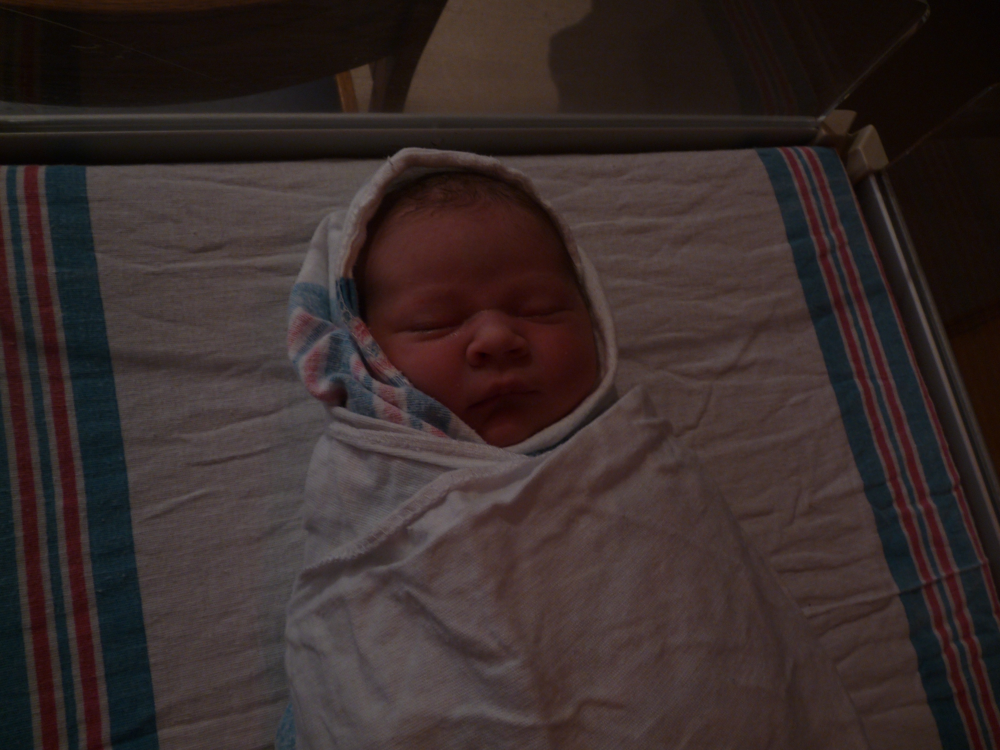


Title   The Human Condition 234
Desc    Person, Man, Clothing, Musical instrument, Jeans, Guitar, Trousers
ID   None
Score   8.167815


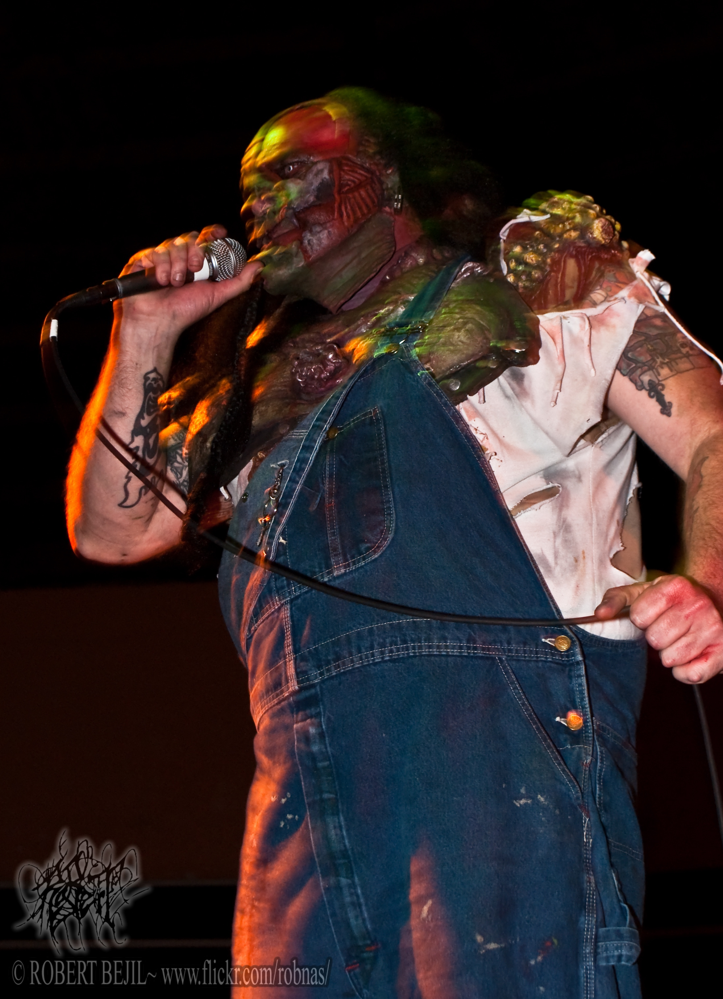


Title   Human Systems Simulation researchers
Desc    Person, Man, Clothing, Footwear, Glasses, Whiteboard
ID   None
Score   8.167815


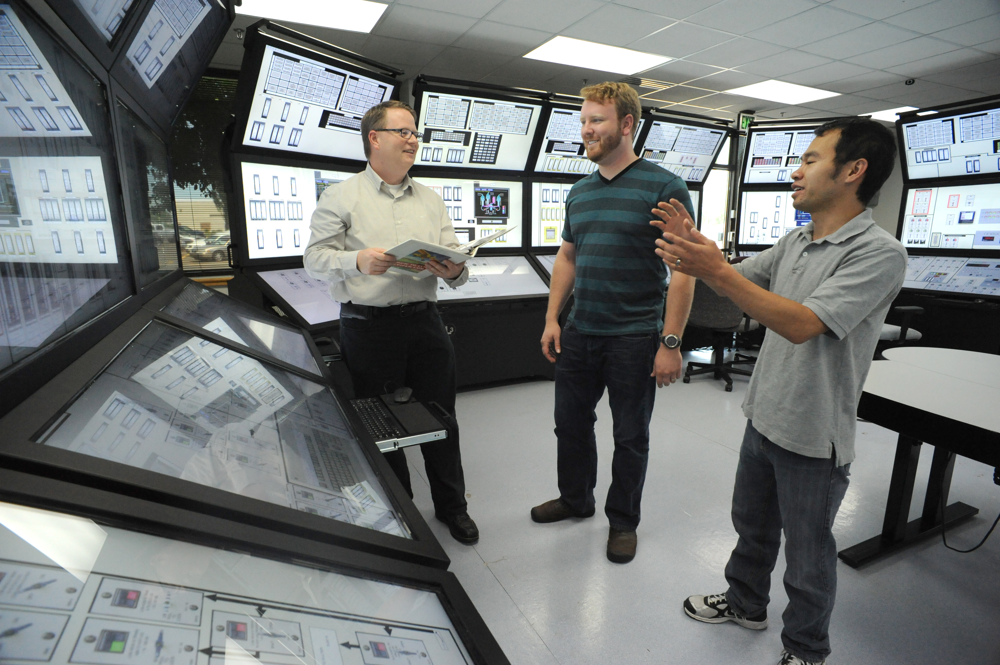


Title   Biogas stove using human excreta
Desc    Person, Suit, Tableware, Man, Clothing, Footwear, Tree, Vase, Trousers, Bowl, Mi...
ID   None
Score   7.41269


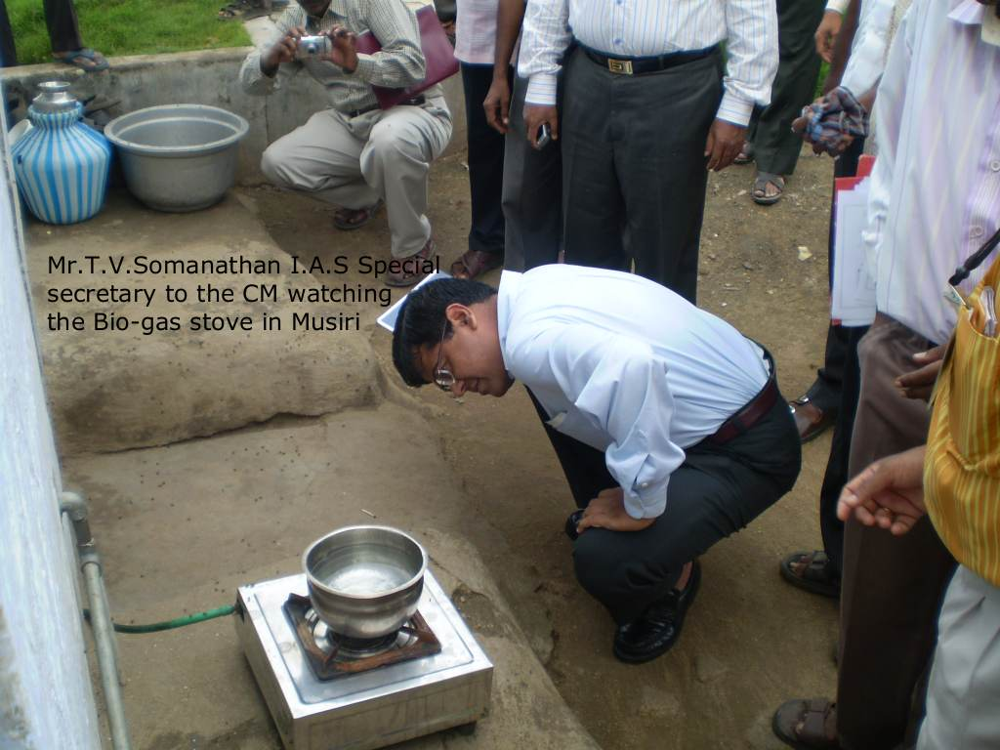


Title   The futility of human existence
Desc    Sink, Plumbing fixture, Tap
ID   None
Score   7.41269


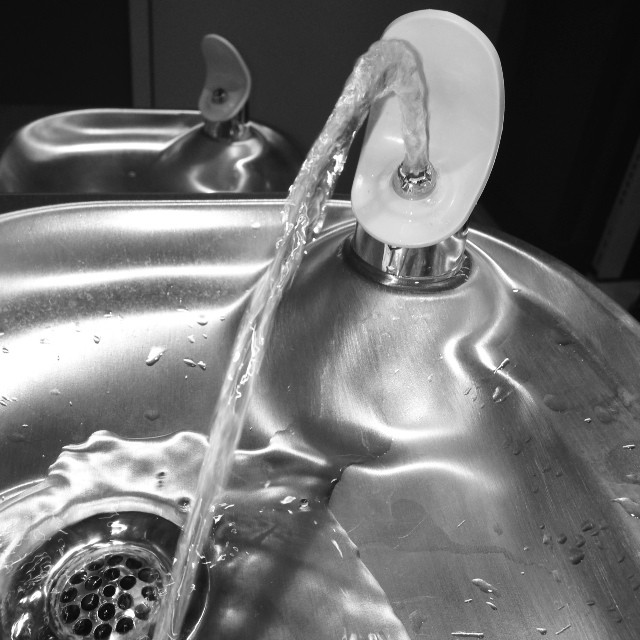

In [31]:
search_by_query("human")

# Search by image similarities using approximate nearest neighbors query

In [20]:
def search_by_image_query(image_id=None, feature_vector=None,size=5):
    if image_id==None and feature_vector==None:
        raise ValueError("Please enter an Image ID or a Feature Vector")
    
    if image_id:
        query = {
            "query":{
                "elastiknn_nearest_neighbors": {
                  "vec": {
                    "index": index,
                    "field": "featureVec",
                    "id": image_id
                    },
                  "field": "featureVec",
                  "model": "lsh",
                  "similarity": "l2",
                  "candidates": 100
                }
            }
            
          }
    elif feature_vector:
        query = {
            "query":{
                "elastiknn_nearest_neighbors": {
                  "vec": {
                      "index": index,
                      "values": feature_vector
                  },
                  "field": "featureVec",
                  "model": "lsh",
                  "similarity": "l2",
                  "candidates": 150
                }
            }
            
          }
    
    res = es.search(index=index, body=query, size=size, _source=source_no_vecs)
    display_hits(res)

In [38]:
def search_by_image_query(image_id=None, feature_vector=None,size=5):
    if image_id==None and feature_vector==None:
        raise ValueError("Please enter an Image ID or a Feature Vector")
    
    if image_id:
        query = {
            "elastiknn_nearest_neighbors": {
              "vec": {
                "index": index,
                "field": "featureVec",
                "id": image_id
              },
              "field": "featureVec",
              "model": "lsh",
              "similarity": "l2",
              "candidates": 100
            }
          }
    elif feature_vector:
        query = {
            "elastiknn_nearest_neighbors": {
              "vec": {
                "values": feature_vector
              },
              "field": "featureVec",
              "model": "lsh",
              "similarity": "l2",
              "candidates": 150
            }
          }
    
    res = es.search(index=index, body=query, size=size, _source=source_no_vecs)
    display_hits(res)

Found 100 hits in 1224 ms. Showing top 5.

Title   Three boys on a hill
Desc    Person, Man, Plant, Clothing
ID   None
Score   1.0


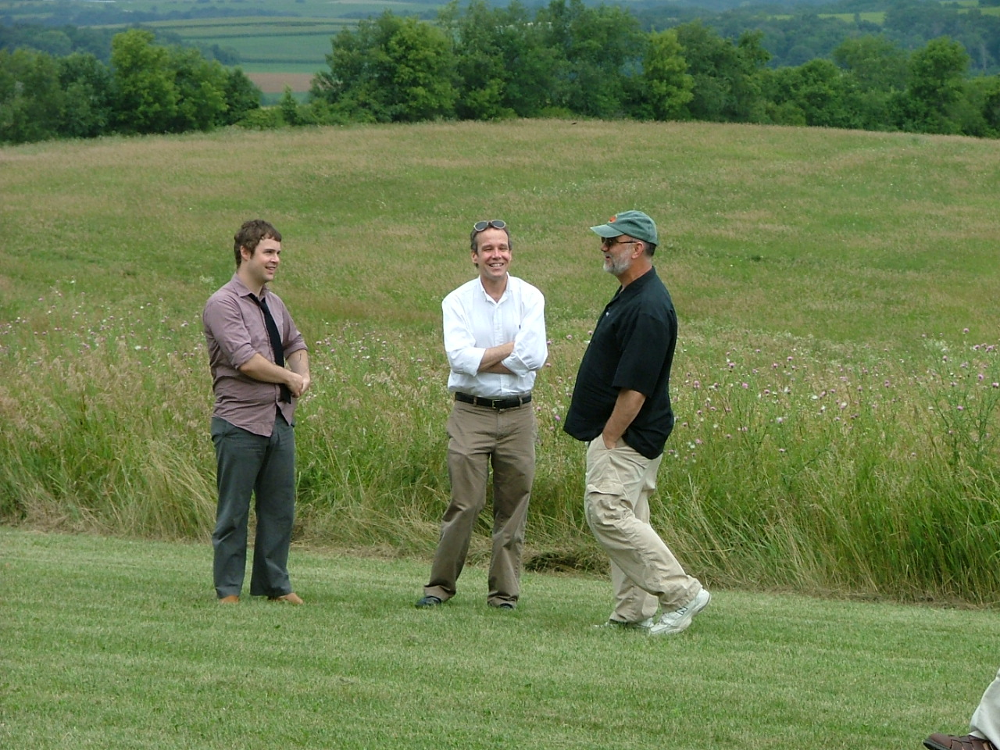


Title   Carried in the Country
Desc    Human eye, Person, Human mouth, Human body, Woman, Human hair, Human head, Man, ...
ID   None
Score   0.945039


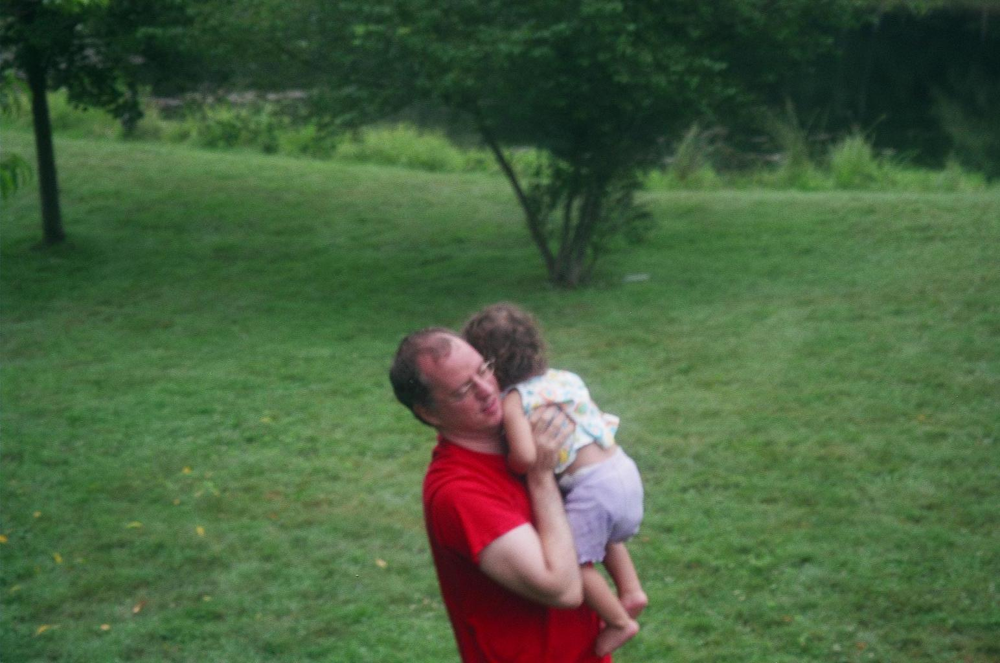


Title   Ballardian scene, outer suburbia. For @DGWBirch
Desc    Plant, Vehicle, Car, Tree
ID   None
Score   0.93987584


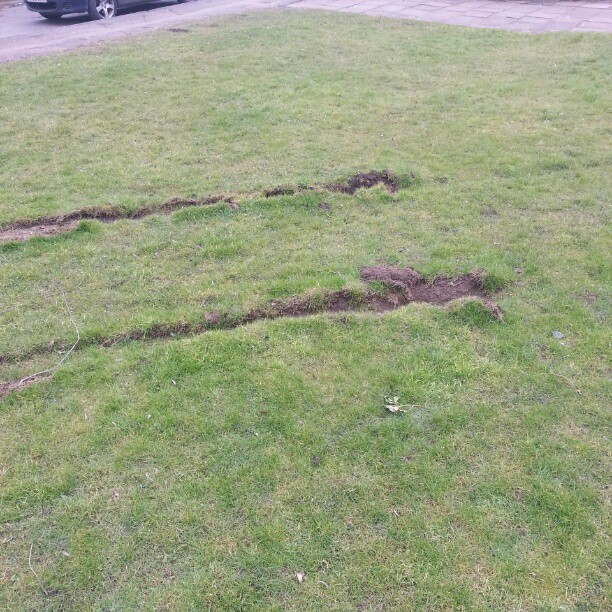


Title   Untitled
Desc    Helmet, Football helmet
ID   None
Score   0.93939626


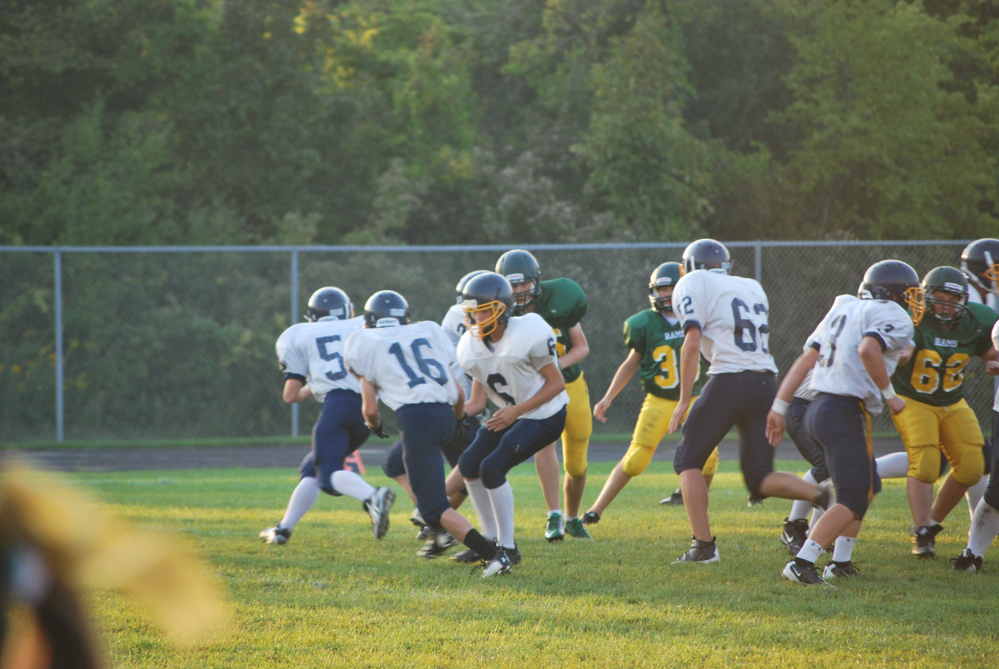


Title   Join me in Europe next month - http://ift.tt/1VKywLD
Desc    Carnivore, Dog, Animal
ID   None
Score   0.9368965


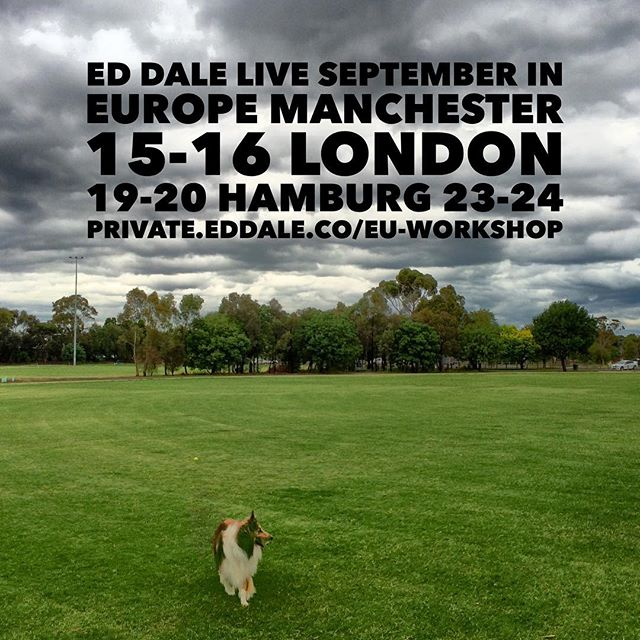

In [21]:
search_by_image_query(image_id="b37f763ae67d0888")

# Combine keyword and nearest neighbors queries

In [26]:
def combined_search(q,image_id=None,feature_vector=None,size=5):
    if image_id==None and feature_vector==None:
        raise ValueError("Please enter an Image ID or a Feature Vector")
    if image_id:
        fetch_res = es.get(index=index, id=image_id)
        query_vec = fetch_res['_source']['featureVec']['values']
        query = {
            'query':{
                "function_score": {
                    "query": {
                        "bool": {
                          "filter": {
                            "exists": {
                              "field": "featureVec"
                            }
                          },
                          "must": {
                            "multi_match": {
                              "query": q,
                              "fields": ["title", "tags","labels"]
                            }
                          }
                        }
                      },
                      "boost_mode": "replace",
                      "functions": [{
                        "elastiknn_nearest_neighbors": {
                          "field": "featureVec",
                          "similarity": "l2",
                          "model": "lsh",
                          "candidates": 100,
                          "vec": {
                            "values": query_vec
                          }
                        },
                        "weight": 2
                      }]
                    }
            }
            
          }
    elif feature_vector:
        query = {
            'query':{
                "function_score": {
                    "query": {
                        "bool": {
                          "filter": {
                            "exists": {
                              "field": "featureVec"
                            }
                          },
                          "must": {
                            "multi_match": {
                              "query": q,
                              "fields": ["Title", "tags"]
                            }
                          }
                        }
                  },
                      "boost_mode": "replace",
                      "functions": [{
                        "elastiknn_nearest_neighbors": {
                          "field": "featureVec",
                          "similarity": "l2",
                              "model": "lsh",
                          "candidates": 100,
                          "vec": {
                        "values": feature_vector
                          }
                        },
                        "weight": 2
                      }]
                    }
                }
            
          }

    res = es.search(index=index, body=query, size=size, _source=source_no_vecs)
    display_hits(res)

Found 10000 hits in 559 ms. Showing top 5.

Title   今日の片手哺乳瓶飲みとらちゃん。朝御飯中に泣いて欲しがった。 (2011/11/24)
Desc    Person, Bottle, Clothing, Human face, Book
ID   None
Score   1.8333334


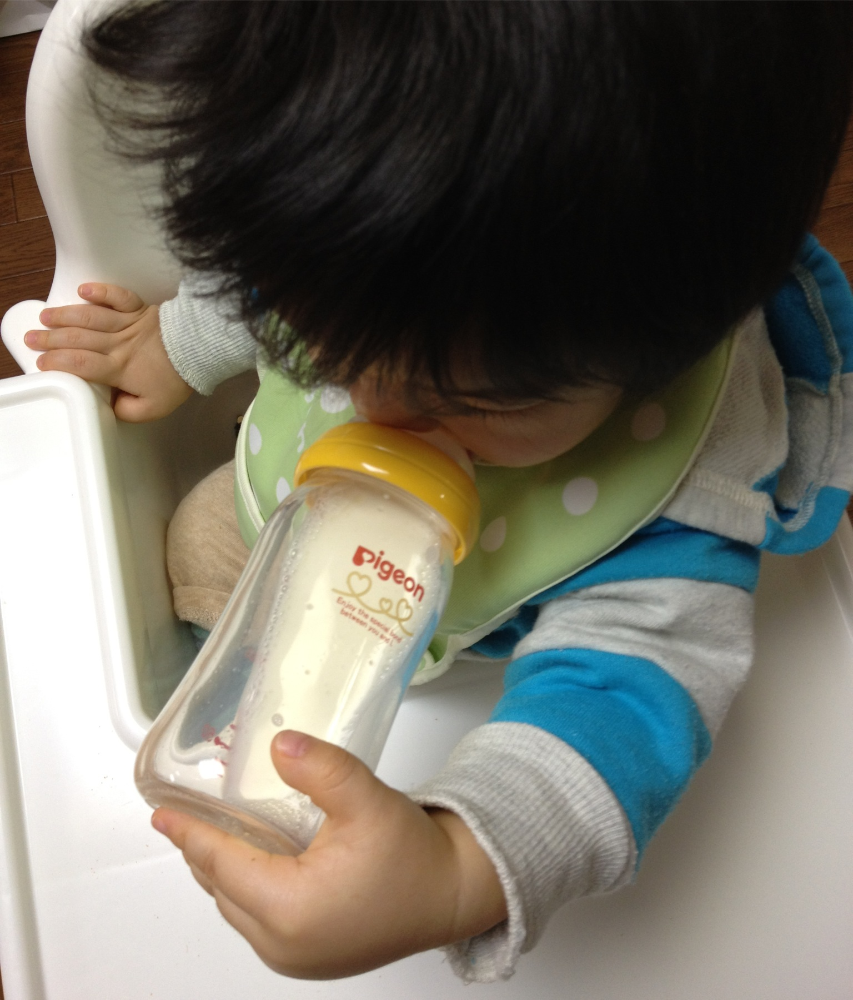


Title   DSC_2423
Desc    Boy, Person, Woman, Bottle, Man, Girl, Clothing, Human face, Laptop
ID   None
Score   1.8333334


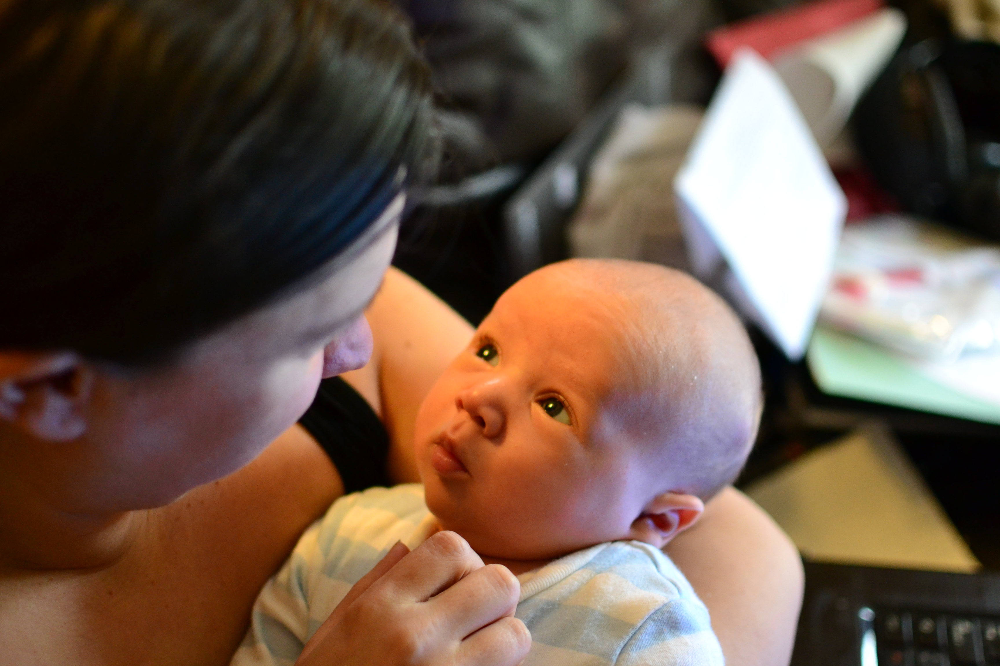


Title   Roadside Vendor
Desc    Person, Land vehicle, Horse, Plant, Vehicle, Clothing, Animal, Tree, Cart
ID   None
Score   1.8333334


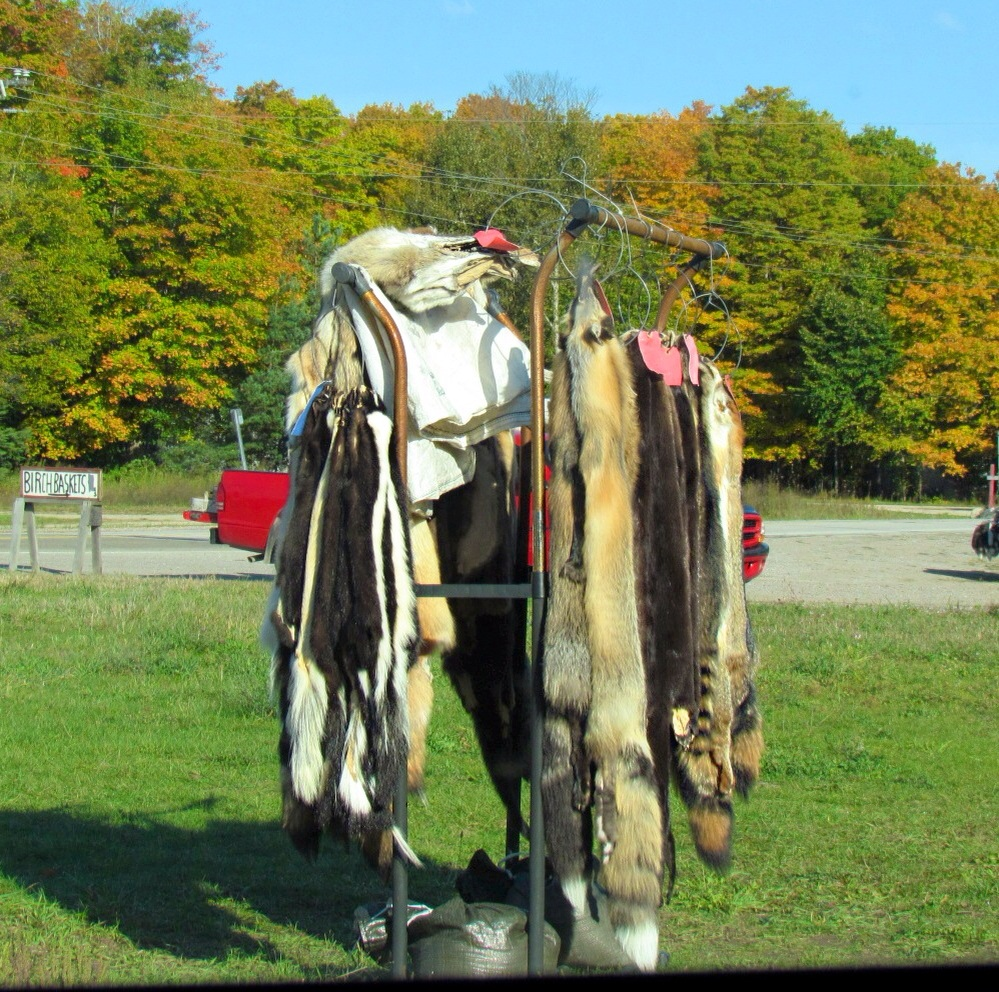


Title   AMP Adopt-A-Highway
Desc    Person, Land vehicle, Plant, Vehicle, Car, Tree
ID   None
Score   1.8333334


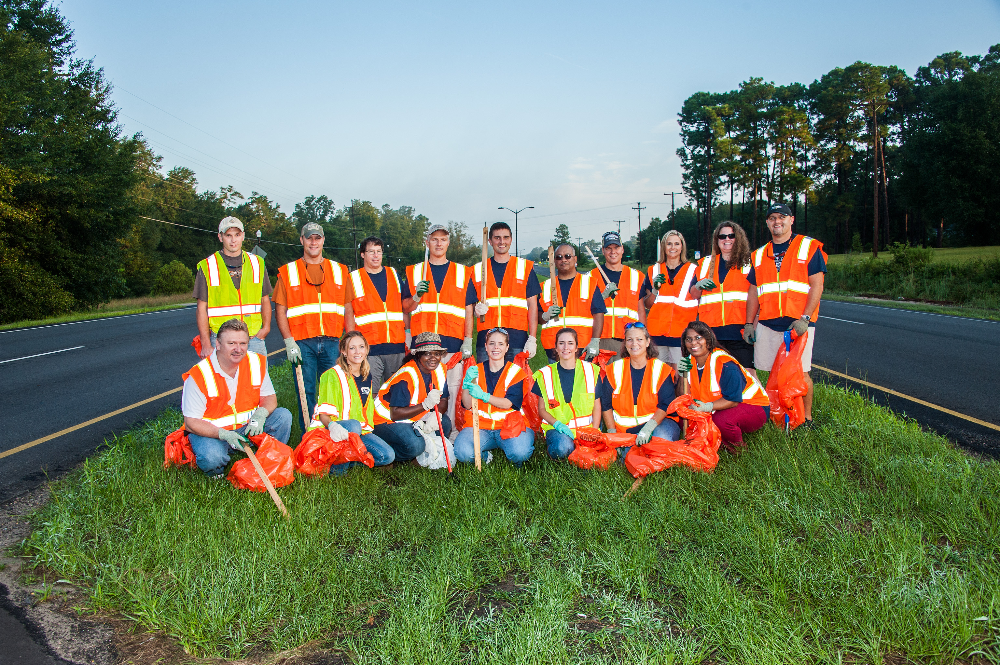


Title   ドラゴン・タトゥーの女 おもしろかった。ハッピーセット食べたくなった。23:32
Desc    Person, Poster, Girl, Human face, Billboard, Book
ID   None
Score   1.8333334


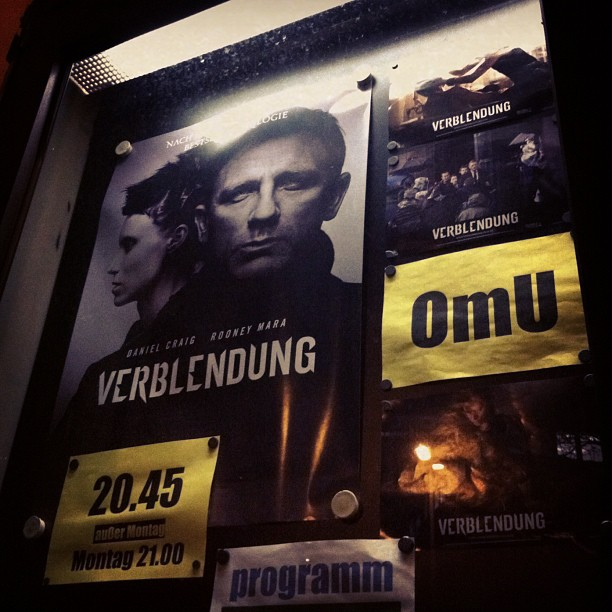

In [25]:
combined_search(q="person",image_id="b37f763ae67d0888")

# ANN from image

In [28]:
# Load features samples for PCA
# !!! Make sure to run once
pca = pkl.load(open("pca.pkl",'rb'))
fe = FeatureExtractor()

C:\Users\LENOVO\anaconda3\envs\tensorflow\lib\site-packages\sklearn\base.py:329: UserWarning: Trying to unpickle estimator PCA from version 1.0 when using version 1.1.3. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [29]:
def load_img(link):
    image=io.imread(link)
    img_features = fe.extract(img=image)
    return pca.transform(img_features.reshape(1,-1))[0].tolist()

In [30]:
x = load_img("https://med.stanford.edu/news/all-news/2021/09/cat-fur-color-patterns/_jcr_content/main/image.img.780.high.jpg/cat_by-Kateryna-T-Unsplash.jpg")

1/1 [==============================] - 1s 1s/step


C:\Users\LENOVO\anaconda3\envs\tensorflow\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


In [79]:
x = load_img("https://www.cnet.com/a/img/CSTqzAl5wJ57HHyASLD-a0vS2O0=/940x528/2021/04/05/9e065d90-51f2-46c5-bd3a-416fd4983c1a/elantra-1080p.jpg")

/home/ghazixx/.local/lib/python3.8/site-packages/sklearn/base.py:445: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


In [81]:
x = load_img("https://images.unsplash.com/photo-1604085572504-a392ddf0d86a?ixid=MnwxMjA3fDB8MHxzZWFyY2h8MXx8b3JhbmdlJTIwZmxvd2VyfGVufDB8fDB8fA%3D%3D&ixlib=rb-1.2.1&w=1000&q=80")

/home/ghazixx/.local/lib/python3.8/site-packages/sklearn/base.py:445: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


In [85]:
x = load_img("https://www.rover.com/blog/wp-content/uploads/2017/02/pug-2648774_1920.jpg")

/home/ghazixx/.local/lib/python3.8/site-packages/sklearn/base.py:445: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


In [111]:
x = load_img("https://images.unsplash.com/photo-1621858170710-2cadd3066b3a?ixlib=rb-1.2.1&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=870&q=80")

/home/ghazixx/.local/lib/python3.8/site-packages/sklearn/base.py:445: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


C:\Users\LENOVO\anaconda3\envs\tensorflow\lib\site-packages\elasticsearch\connection\base.py:208: ElasticsearchWarning: Elasticsearch built-in security features are not enabled. Without authentication, your cluster could be accessible to anyone. See https://www.elastic.co/guide/en/elasticsearch/reference/7.14/security-minimal-setup.html to enable security.
  warnings.warn(message, category=ElasticsearchWarning)


Found 150 hits in 216 ms. Showing top 5.

Title   Anish Kapoor Sky Mirror
Desc    Plant, Tree
ID   None
Score   0.55698526


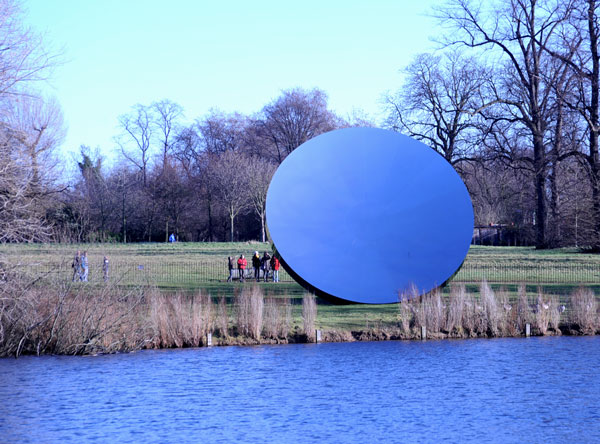


Title   Trees in Canola field
Desc    Plant, Tree
ID   None
Score   0.5562122


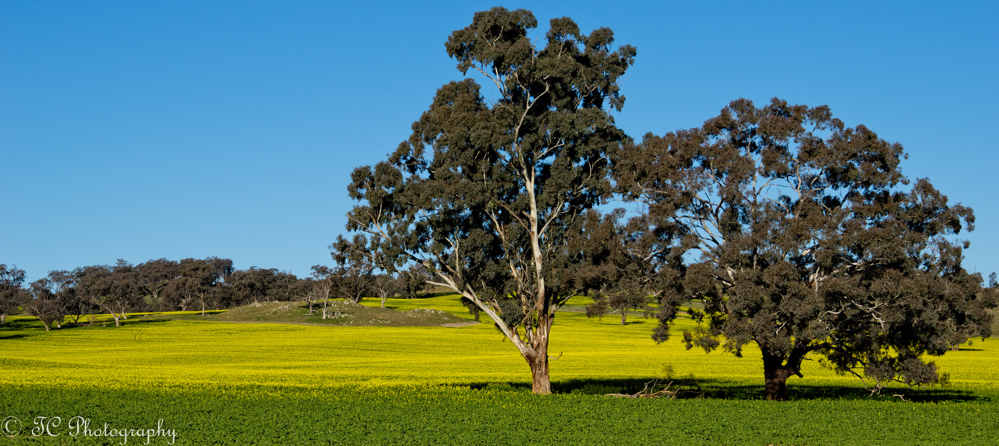


Title   Bald Eagle
Desc    Bird, Animal, Eagle
ID   None
Score   0.5558758


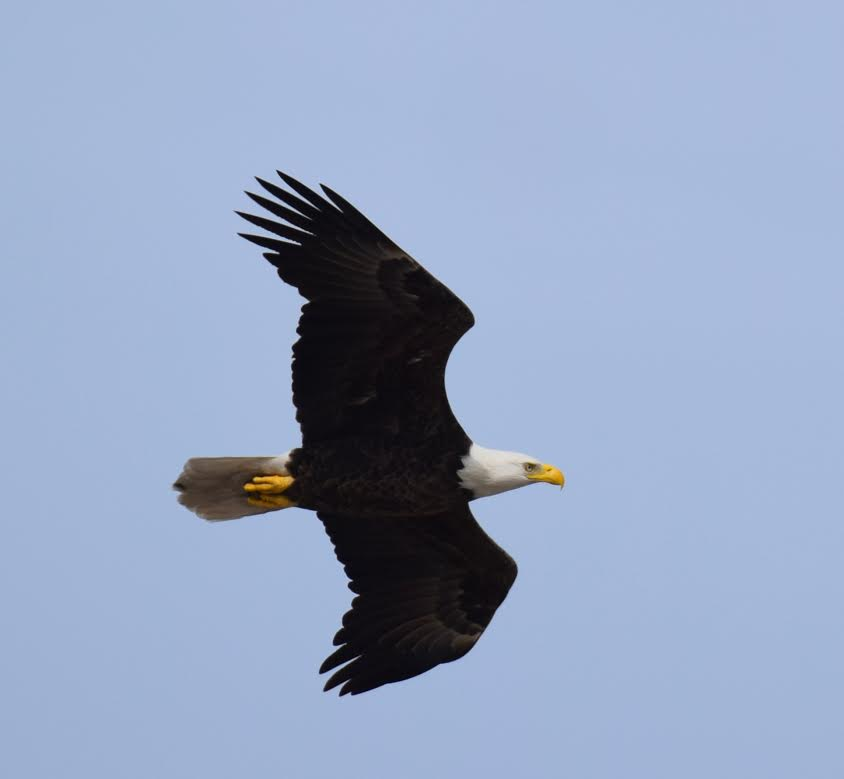


Title   4
Desc    Plant, Flower, Tree
ID   None
Score   0.55546117


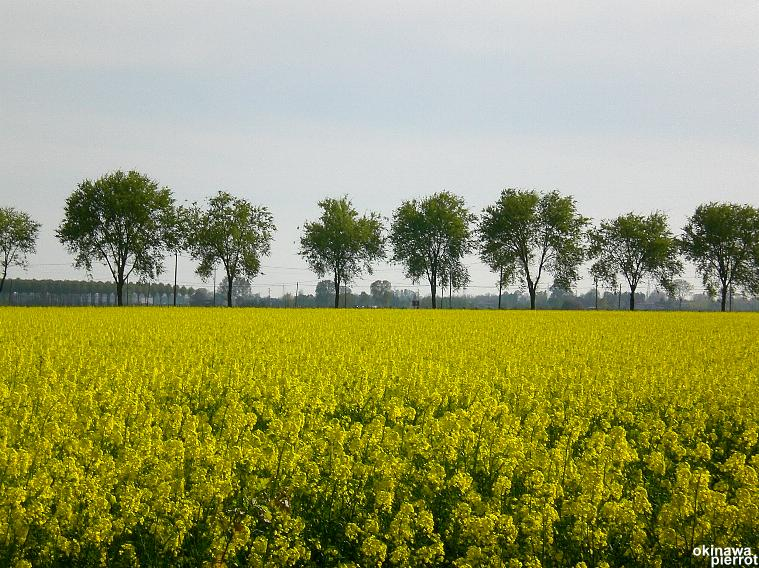


Title   Whistler
Desc    Person, Plant, Clothing, Footwear, Sports equipment, Tree, Snowboard
ID   None
Score   0.5554393


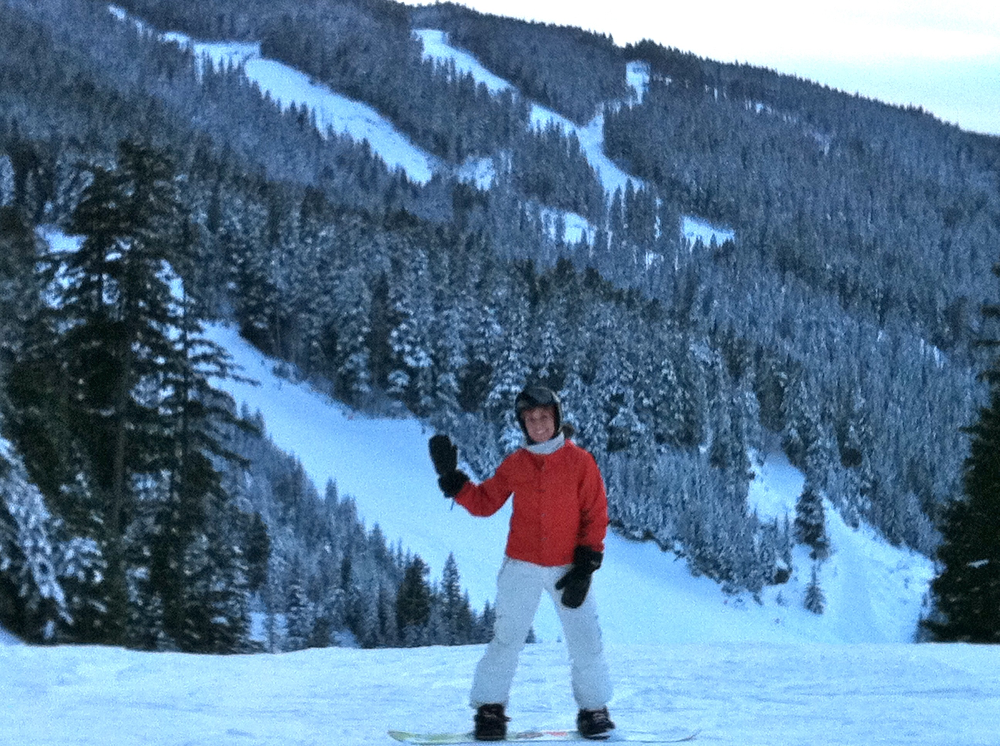

In [31]:
search_by_image_query(feature_vector=x,size=5)